In [6]:
#cnn-rnn using custom CNN model
from tensorflow import keras
from tensorflow_docs.vis import embed
from imutils import paths

import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [7]:
IMG_W = 224
IMG_H = 224
BATCH_SIZE = 64
EPOCHS = 25

MAX_SEQ_LENGTH = 1000
NUM_FEATURES = 2048

In [8]:
df1 = pd.read_csv("../data/female-mirror-data.csv")
df1["Action"] = df1["Action"].str.rstrip()
df1.head()

,Female Participant Number,Action,video-name,Unnamed: 3
0,1,Normal,1-FemaleNoGlasses-Normal.avi,NaN
1,1,Talking,1-FemaleNoGlasses-Talking.avi,NaN
2,1,Yawning,1-FemaleNoGlasses-Yawning.avi,NaN
3,2,Normal,2-FemaleNoGlasses-Normal.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...
4,2,Talking,2-FemaleNoGlasses-Talking.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...


In [9]:

def crop_center_square(frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]


def load_video(path, max_frames=0, resize=(IMG_H, IMG_W)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)


In [10]:
reconstructed_model = keras.models.load_model("../data/yawning_model.h5")

In [11]:

def build_feature_extractor():
    feature_extractor = reconstructed_model
    preprocess_input = keras.applications.inception_resnet_v2.preprocess_input

    inputs = keras.Input((IMG_H, IMG_W, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")


feature_extractor = build_feature_extractor()

In [12]:
"""label_processor = tf.keras.layers.StringLookup(
    num_oov_indices=0, vocabulary=np.unique(df1['Action'])
)
print(label_processor.get_vocabulary())"""

"label_processor = tf.keras.layers.StringLookup(\n    num_oov_indices=0, vocabulary=np.unique(df1['Action'])\n)\nprint(label_processor.get_vocabulary())"

In [13]:
df1["target"] = (df1["Action"]=="Yawning")

In [14]:
i = 0
dfTrain = pd.DataFrame()
dfTest = pd.DataFrame()

while i<len(df1)/10:
    if i%5==0:
        dfTest = dfTest.append(df1.iloc[[i]])
    else :
        dfTrain = dfTrain.append(df1.iloc[[i]])

    i+=1

In [15]:
dfTest

,Female Participant Number,Action,video-name,Unnamed: 3,target
0,1,Normal,1-FemaleNoGlasses-Normal.avi,NaN,False
5,2,Yawning,2-FemaleNoGlasses-Yawning.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,True
10,4,Talking,4-FemaleGlasses-Talking.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,False
15,6,Normal,6-FemaleNoGlasses-Normal.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,False


In [16]:

def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = df["video-name"].values.tolist()
    # print(video_paths)
    labels = df["target"].values
    #labels = label_processor(labels[..., None]).numpy()

    # `frame_masks` and `frame_features` are what we will feed to our sequence model.
    # `frame_masks` will contain a bunch of booleans denoting if a timestep is
    # masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )

    # For each video.
    for idx, path in enumerate(video_paths):
        # Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]

        # Initialize placeholders to store the masks and features of the current video.
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )

        # Extract features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features[i, j, :] = feature_extractor.predict(
                    batch[None, j, :]
                )
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels


#train_data, train_labels = prepare_all_videos(dfTrain, "../Data/Mirror/")
#test_data, test_labels = prepare_all_videos(dfTest, "../Data/Mirror/")
train_data, train_labels = prepare_all_videos(dfTrain, "../data/YawDD/YawDD dataset/Mirror/Female_mirror/")
test_data, test_labels = prepare_all_videos(dfTest, "../data/YawDD/YawDD dataset/Mirror/Female_mirror/")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

Frame features in train set: (12, 1000, 2048)
Frame masks in train set: (12, 1000)


In [28]:
# Utility for our sequence model.
def get_sequence_model():
    #class_vocab = label_processor.get_vocabulary()

    frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
    mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

    x = keras.layers.GRU(16, return_sequences=True)(
        frame_features_input, mask=mask_input
    )
    x = keras.layers.GRU(8)(x)
    x = keras.layers.Dropout(0.4)(x)
    x = keras.layers.Dense(8, activation="relu")(x)
    #output = keras.layers.Dense(len(class_vocab), activation="softmax")(x)
    output = keras.layers.Dense(1, activation='sigmoid')(x)

    rnn_model = keras.Model([frame_features_input, mask_input], output)

    rnn_model.compile(
        #loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"]
        loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"]
    )
    return rnn_model

# Utility for running experiments.
def run_experiment():
    filepath = "./video_classifier"
    checkpoint = keras.callbacks.ModelCheckpoint(
        filepath, save_weights_only=True, save_best_only=True, verbose=1
    )

    seq_model = get_sequence_model()
    history = seq_model.fit(
        [train_data[0], train_data[1]],
        train_labels,
        validation_split=0.3,
        epochs=EPOCHS,
        callbacks=[checkpoint],
    )

    seq_model.load_weights(filepath)
    _, accuracy = seq_model.evaluate([test_data[0], test_data[1]], test_labels)
    print(f"Test accuracy: {round(accuracy * 100, 2)}%")

    return history, seq_model


_, sequence_model = run_experiment()

Epoch 1/25
1/1 [==============================] - 22s 22s/step - loss: 0.5484 - accuracy: 0.8750 - val_loss: 0.8000 - val_accuracy: 0.5000

Epoch 00001: val_loss improved from inf to 0.79997, saving model to .\video_classifier
Epoch 2/25
1/1 [==============================] - 0s 352ms/step - loss: 0.5059 - accuracy: 0.7500 - val_loss: 0.7892 - val_accuracy: 0.5000

Epoch 00002: val_loss improved from 0.79997 to 0.78924, saving model to .\video_classifier
Epoch 3/25
1/1 [==============================] - 0s 380ms/step - loss: 0.7195 - accuracy: 0.7500 - val_loss: 0.7819 - val_accuracy: 0.5000

Epoch 00003: val_loss improved from 0.78924 to 0.78188, saving model to .\video_classifier
Epoch 4/25
1/1 [==============================] - 0s 388ms/step - loss: 0.5828 - accuracy: 0.7500 - val_loss: 0.7839 - val_accuracy: 0.5000

Epoch 00004: val_loss did not improve from 0.78188
Epoch 5/25
1/1 [==============================] - 0s 360ms/step - loss: 0.5393 - accuracy: 0.7500 - val_loss: 0.7901 

Test video path: 2-FemaleNoGlasses-Yawning.avi
586
  Not Yawning: 69.73%
  Yawning: 30.27%



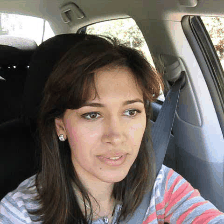

In [27]:

def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        print(length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask


def sequence_prediction(path):
    #class_vocab = label_processor.get_vocabulary()
    class_vocab = ["Yawning"]

    frames = load_video(os.path.join("../data/YawDD/YawDD dataset/Mirror/Female_mirror/", path))
    frame_features, frame_mask = prepare_single_video(frames)
    probabilities = sequence_model.predict([frame_features, frame_mask])[0]

    for i in np.argsort(probabilities)[::-1]:
        print(f"  {class_vocab[i]}: {probabilities[i] * 100:5.2f}%")
    return frames

def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=30)
    return embed.embed_file("animation.gif")

test_video = np.random.choice(dfTest["video-name"].values.tolist())
#print(f"Test video path: {test_video}")
#test_frames = sequence_prediction(test_video)
print(f"Test video path: 2-FemaleNoGlasses-Yawning.avi")
test_frames = sequence_prediction("2-FemaleNoGlasses-Yawning.avi	")
to_gif(test_frames[:MAX_SEQ_LENGTH])

In [20]:
dfTest

,Female Participant Number,Action,video-name,Unnamed: 3,target
0,1,Normal,1-FemaleNoGlasses-Normal.avi,NaN,False
5,2,Yawning,2-FemaleNoGlasses-Yawning.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,True
10,4,Talking,4-FemaleGlasses-Talking.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,False
15,6,Normal,6-FemaleNoGlasses-Normal.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...,False
